In [1]:
import os
import json
import glob
import random
import collections
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import layers
import numpy as np
import pandas as pd
import pydicom
from pydicom.pixel_data_handlers.util import apply_voi_lut
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import random
from tqdm.notebook import tqdm

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# Load the training data from the CSV file
train_df = pd.read_csv("../input/rsna-miccai-brain-tumor-radiogenomic-classification/train_labels.csv")

# Display the training data
train_df

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
...,...,...
580,1005,1
581,1007,1
582,1008,1
583,1009,0


<AxesSubplot: xlabel='MGMT_value', ylabel='count'>

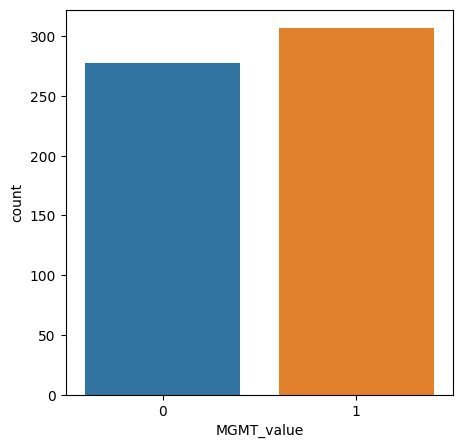

In [3]:
# Set the figure size and create a count plot of the MGMT_value variable
plt.figure(figsize=(5, 5))
sns.countplot(data=train_df, x="MGMT_value")

In [4]:
# Define a function to load DICOM files
def load_dicom_file(path):
    dicom_file = pydicom.read_file(path)
    pixel_array = dicom_file.pixel_array
    pixel_array = pixel_array - np.min(pixel_array)
    if np.max(pixel_array) != 0:
        pixel_array = pixel_array / np.max(pixel_array)
    pixel_array = (pixel_array * 255).astype(np.uint8)
    return pixel_array

# Define a function to visualize a sample of brain tumor radiogenomic data
def visualize_sample(brats21id, slice_i, mgmt_value, types=("FLAIR", "T1w", "T1wCE", "T2w")):
    plt.figure(figsize=(16, 5))
    patient_path = os.path.join(
        "../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/", 
        str(brats21id).zfill(5),
    )
    for i, t in enumerate(types, 1):
        t_paths = sorted(
            glob.glob(os.path.join(patient_path, t, "*")), 
            key=lambda x: int(x[:-4].split("-")[-1]),
        )
        pixel_array = load_dicom_file(t_paths[int(len(t_paths) * slice_i)])
        plt.subplot(1, 4, i)
        plt.imshow(pixel_array, cmap="gray")
        plt.title(f"{t}", fontsize=16)
        plt.axis("off")

    plt.suptitle(f"MGMT_value: {mgmt_value}", fontsize=16)
    plt.show()

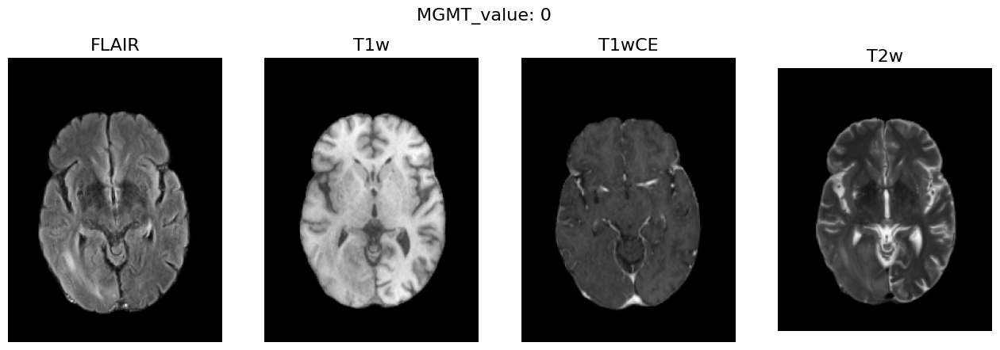

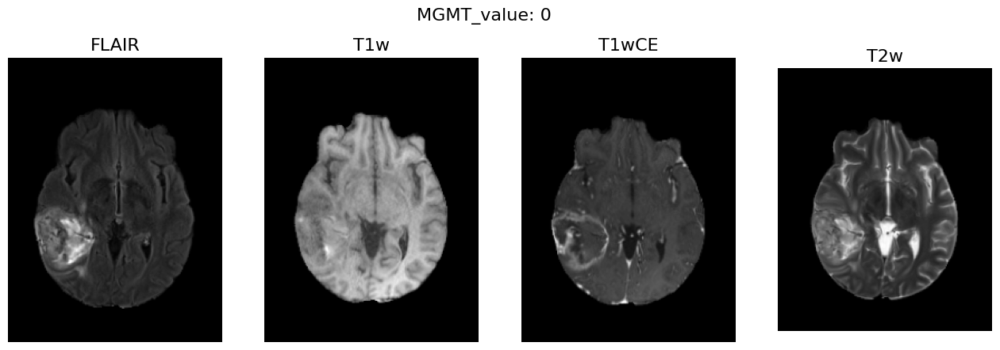

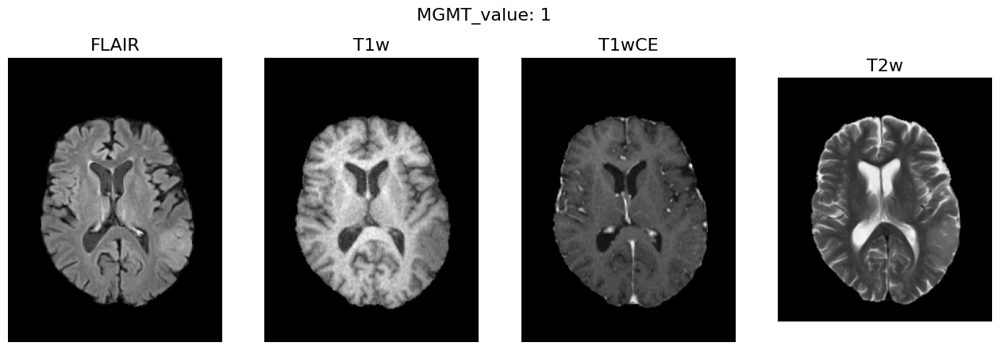

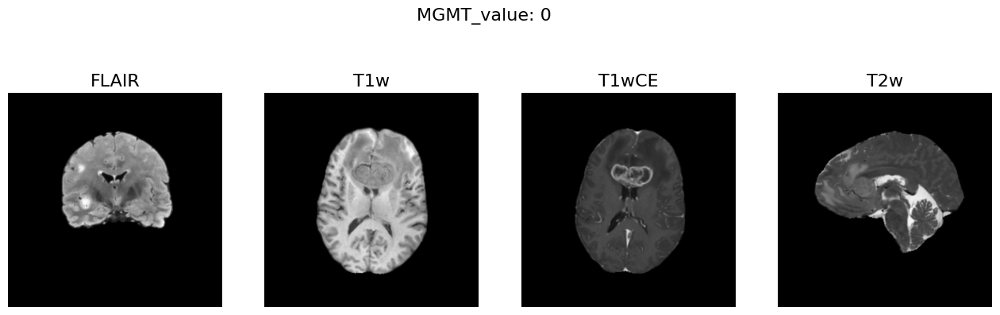

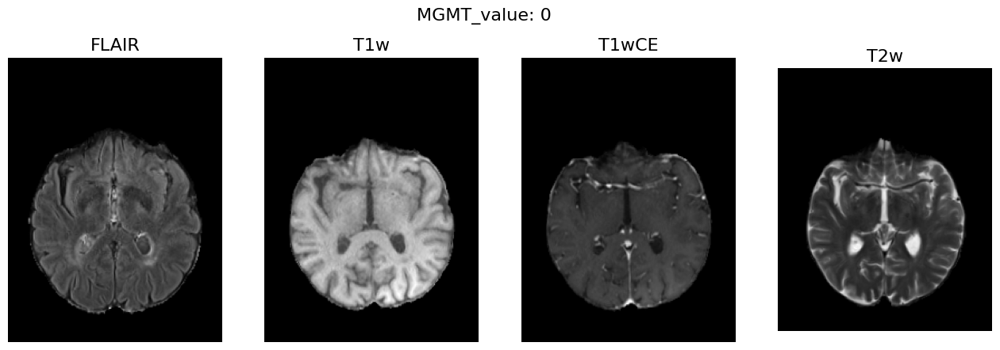

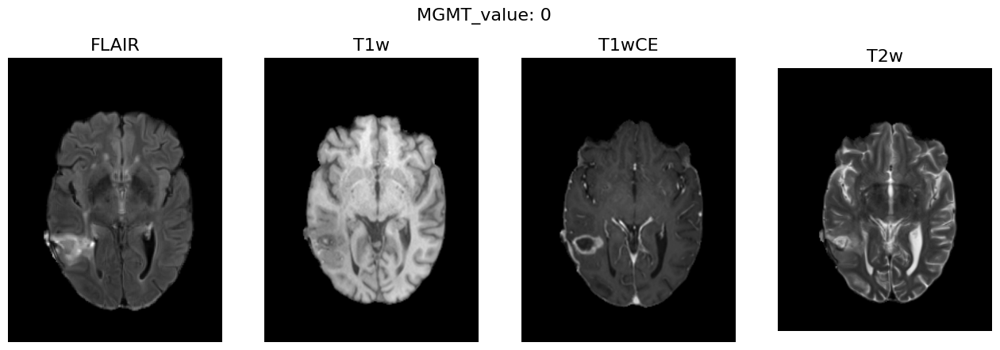

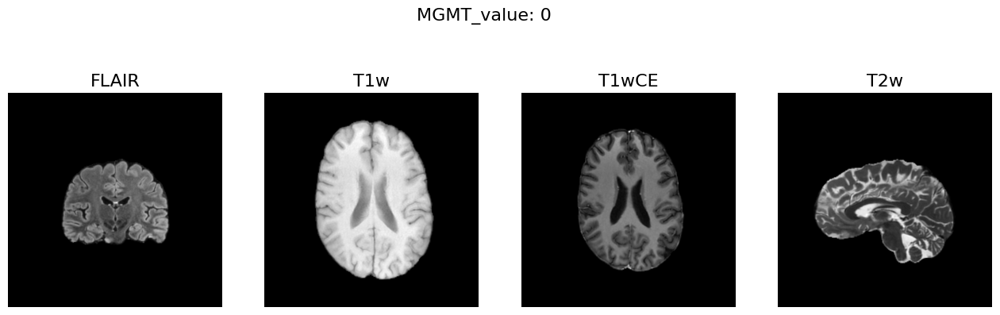

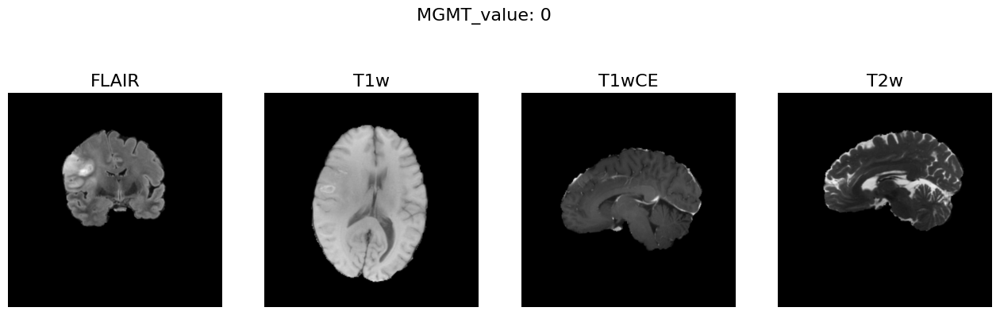

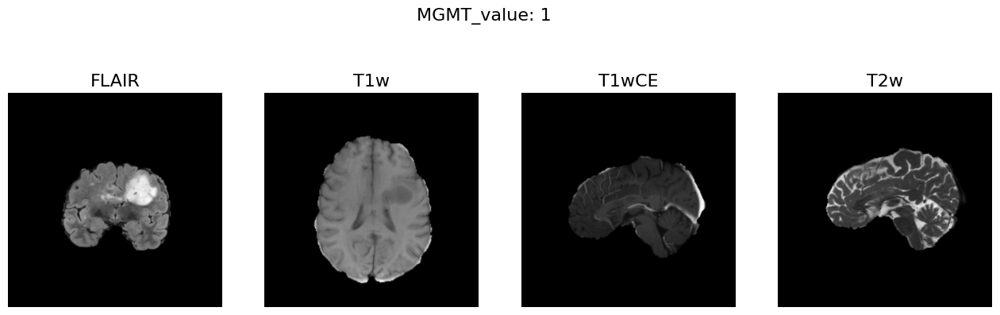

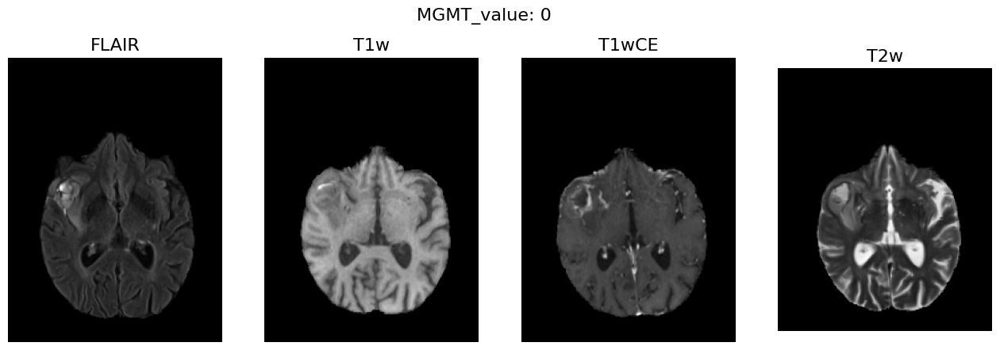

In [5]:
# Select a random sample of 10 brain tumor radiogenomic images from the training dataset
random_indices = random.sample(range(train_df.shape[0]), 10)

# Visualize each sample using the `visualize_sample()` function
for i in random_indices:
    brats21id = train_df.iloc[i]["BraTS21ID"]
    mgmt_value = train_df.iloc[i]["MGMT_value"]
    visualize_sample(brats21id=brats21id, mgmt_value=mgmt_value, slice_i=0.5)

In [6]:
from matplotlib import animation, rc
rc('animation', html='jshtml')


def create_animation(ims):
    fig = plt.figure(figsize=(6, 6))
    plt.axis('off')
    im = plt.imshow(ims[0], cmap="gray")

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//24)

In [7]:
def load_dicom_images(path):
    """
    Loads a sequence of DICOM images from a directory.

    Args:
    - path: The path to the directory containing the DICOM files.

    Returns:
    - A list of 2D arrays representing the DICOM images.
    """
    # Get the paths to the DICOM files and sort them by slice number
    dicom_paths = sorted(
        glob.glob(os.path.join(path, "*")), 
        key=lambda x: int(x[:-4].split("-")[-1]),
    )

    # Load the DICOM images into a list
    images = []
    for path in dicom_paths:
        image = load_dicom_file(path)
        if image.max() != 0:
            images.append(image)

    return images

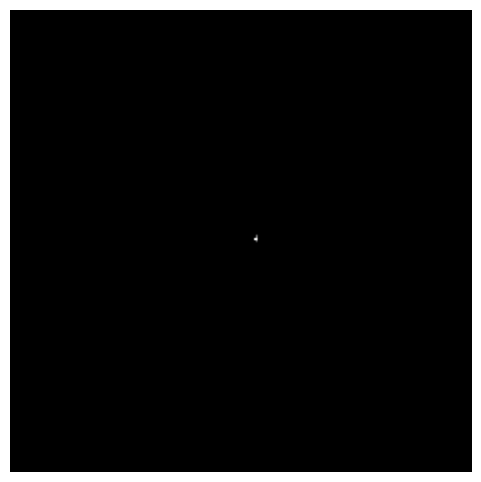

In [8]:
images = load_dicom_images("../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/00000/FLAIR")
create_animation(images)

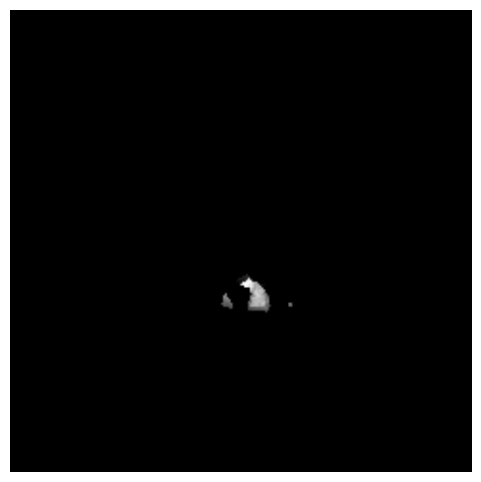

In [9]:
images = load_dicom_images("../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/00000/T1w")
create_animation(images)

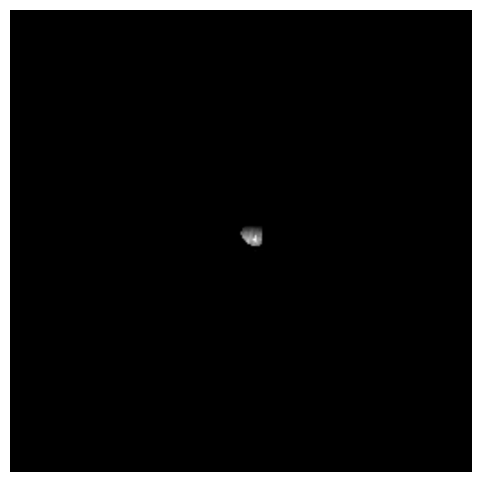

In [10]:
images = load_dicom_images("../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/00000/T1wCE")
create_animation(images)

File count: 129
Skipped, no SliceLocation: 0


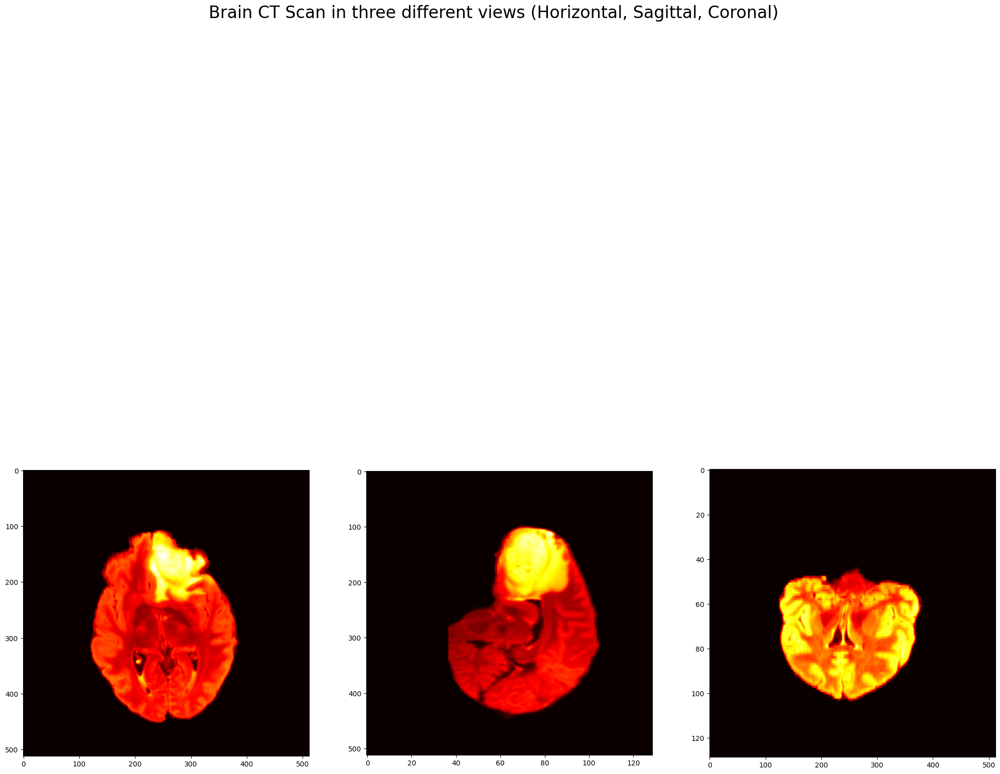

In [11]:
from pathlib import Path

def plot_brain_3d(directory):
    # Load all DICOM files in the directory
    files = sorted([os.path.join(directory, f) for f in os.listdir(directory) if f.endswith('.dcm')], key=lambda path: int(os.path.splitext(os.path.basename(path))[0].split('-')[-1]))

    print("File count: {}".format(len(files)))

    # Load the DICOM files into memory and skip those with no SliceLocation attribute
    slices = []
    skipcount = 0
    for fname in files:
        ds = pydicom.dcmread(fname)
        if hasattr(ds, 'SliceLocation'):
            slices.append(ds)
        else:
            skipcount += 1
    print("Skipped, no SliceLocation: {}".format(skipcount))

    # Sort the slices based on their SliceLocation attribute
    slices = sorted(slices, key=lambda s: s.SliceLocation)

    # Calculate pixel aspect ratios for each view
    ps = slices[0].PixelSpacing
    ss = slices[0].SliceThickness
    ax_aspect = ps[1]/ps[0]
    sag_aspect = ps[1]/ss
    cor_aspect = ss/ps[0]

    # Create a 3D array to store the image data
    img_shape = list(slices[0].pixel_array.shape)
    img_shape.append(len(slices))
    img3d = np.zeros(img_shape)

    # Fill the 3D array with the pixel data from each slice
    for i, s in enumerate(slices):
        img2d = s.pixel_array
        img3d[:, :, i] = img2d

    # Plot the 3 orthogonal views
    fig, axes = plt.subplots(1, 3, figsize=(25, 25))
    fig.suptitle("Brain CT Scan in three different views (Horizontal, Sagittal, Coronal)", fontsize=24)

    axes[0].imshow(img3d[:, :, img_shape[2]//2], cmap='hot')
    axes[0].set_aspect(ax_aspect)

    axes[1].imshow(img3d[:, img_shape[1]//2, :], cmap='hot')
    axes[1].set_aspect(sag_aspect)

    axes[2].imshow(img3d[img_shape[0]//2, :, :].T, cmap='hot')
    axes[2].set_aspect(cor_aspect)

    plt.show()

# Example usage: plot 3D brain scans in the directory '../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/00006/FLAIR/'
directory = '../input/rsna-miccai-brain-tumor-radiogenomic-classification/train/00006/FLAIR/'
plot_brain_3d(directory)

In [12]:
os.listdir('/kaggle/input/')
mri_types = ["FLAIR", "T1w", "T2w", "T1wCE"]
threshold = 10
exc = [109, 123, 709]

In [13]:
train_df = pd.read_csv("/kaggle/input/rsna-miccai-brain-tumor-radiogenomic-classification/train_labels.csv")
train_df.head(10)

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
5,8,1
6,9,0
7,11,1
8,12,1
9,14,1


In [14]:
test_df = pd.read_csv("/kaggle/input/rsna-miccai-brain-tumor-radiogenomic-classification/sample_submission.csv")
test_df.head(10)

,BraTS21ID,MGMT_value
0,1,0.5
1,13,0.5
2,15,0.5
3,27,0.5
4,37,0.5
5,47,0.5
6,79,0.5
7,80,0.5
8,82,0.5
9,91,0.5


In [15]:
train_df = train_df[~train_df.BraTS21ID.isin(exc)]
train_df.head(10)

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
5,8,1
6,9,0
7,11,1
8,12,1
9,14,1


In [16]:
# Dicom image, standardizes so that pixel values are between 0 and 1
# Rescale to 0 and 255
def dicomImage(path, size = 224):
    dicom = pydicom.read_file(path)
    data = dicom.pixel_array
    if np.max(data) != 0:
        data = data / np.max(data)
    data = (data * 255).astype(np.uint8)
    return cv2.resize(data, (size, size))

# Returns an arry of all the images of a particular type for a particular patient ID
def allImagePath(brats21id, image_type, folder='train'): 
    assert(image_type in mri_types)
    
    patient_path = os.path.join(
        "../input/rsna-miccai-brain-tumor-radiogenomic-classification/%s/" % folder, 
        str(brats21id).zfill(5),
    )

    paths = sorted(
        glob.glob(os.path.join(patient_path, image_type, "*")), 
        key=lambda x: int(x[:-4].split("-")[-1]),
    )
    
    num_images = len(paths)
    
    start = int(num_images * 0.25)
    end = int(num_images * 0.75)

    interval = 3
    
    if num_images < 10: 
        interval = 1
    
    return np.array(paths[start:end:interval])

def get_all_images(brats21id, image_type, folder='train', size=225):
    return [dicomImage(path, size) for path in allImagePath(brats21id, image_type, folder)]

In [17]:
imgaeSize = 128

def get_all_data_for_train(image_type):
    global train_df
    var1 = []
    var2 = []
    train_ids = []

    for i in tqdm(train_df.index):
        x = train_df.loc[i]
        allImages = get_all_images(int(x['BraTS21ID']), image_type, 'train', imgaeSize)
        label = x['MGMT_value']
        var1 += allImages
        var2 += [label] * len(allImages)
        train_ids += [int(x['BraTS21ID'])] * len(allImages)
        assert(len(var1) == len(var2))
    return np.array(var1), np.array(var2), np.array(train_ids)

def get_all_data_for_test(image_type):
    global test_df
    var1 = []
    test_ids = []

    for i in tqdm(test_df.index):
        x = test_df.loc[i]
        allImages = get_all_images(int(x['BraTS21ID']), image_type, 'test', imgaeSize)
        var1 += allImages
        test_ids += [int(x['BraTS21ID'])] * len(allImages)

    return np.array(var1), np.array(test_ids)

In [18]:
X, Y, train_idt = get_all_data_for_train('T1wCE')
X_test, test_idt = get_all_data_for_test('T1wCE')
X.shape, Y.shape, train_idt.shape, test_idt.shape

  0%|          | 0/582 [00:00<?, ?it/s]

  0%|          | 0/87 [00:00<?, ?it/s]

((16196, 128, 128), (16196,), (16196,), (2417,))

In [19]:
X.shape, Y.shape

((16196, 128, 128), (16196,))

In [20]:
X_train, X_valid, y_train, y_valid, trainidt_train, trainidt_valid = train_test_split(X, Y, train_idt, test_size=0.1, random_state=140)
split = int(X.shape[0] * 0.9)

In [21]:
X_train = tf.expand_dims(X_train, axis = -1)
X_valid = tf.expand_dims(X_valid, axis = -1)

y_train = to_categorical(y_train)
y_valid = to_categorical(y_valid)

In [22]:
X_train.shape, y_train.shape, X_valid.shape, y_valid.shape, trainidt_train.shape, trainidt_valid.shape

(TensorShape([14576, 128, 128, 1]),
 (14576, 2),
 TensorShape([1620, 128, 128, 1]),
 (1620, 2),
 (14576,),
 (1620,))

In [23]:
np.random.seed(0)
random.seed(12)
tf.random.set_seed(12)

inputShape = keras.Input(shape = X_train.shape[1:])

preProcessing = keras.layers.experimental.preprocessing.Rescaling(1./255)(inputShape)
# h = augmentation(h)

# convolutional layer!
l = keras.layers.Conv2D(32, kernel_size=(3, 3),strides=(1,1), activation="relu", name="Conv_1", padding="valid")(preProcessing) 
l = tf.keras.layers.BatchNormalization(axis=-1)(l)
l = keras.layers.Conv2D(32, kernel_size=(3, 3),strides=(1,1), activation="relu", name="Conv_1b", padding="same")(l) 
l = tf.keras.layers.BatchNormalization(axis=-1)(l)
l = keras.layers.MaxPool2D(pool_size=(2,2))(l)
l = keras.layers.Conv2D(64, kernel_size=(3, 3),strides=(1,1), activation="relu", name="Conv_2", padding="valid")(l) 
l = tf.keras.layers.BatchNormalization(axis=-1)(l)

# pooling layer
l = keras.layers.MaxPool2D(pool_size=(2,2))(l)
l = tf.keras.layers.BatchNormalization(axis=-1)(l)

# convolutional layer!
l = keras.layers.Conv2D(64, kernel_size=(3, 3), activation="relu", name="Conv_3",padding ="same")(l)

# pooling layer
l = tf.keras.layers.BatchNormalization(axis=-1)(l)
l = keras.layers.Dropout(0.4)(l)
l = keras.layers.Flatten()(l)
l1 = keras.layers.experimental.preprocessing.Rescaling(1./255)(preProcessing)
l1 =  keras.layers.MaxPool2D(strides=(5,5))(l1)
l1 = keras.layers.Conv2D(32, kernel_size=(3, 3), activation="swish", name="Conv_4b")(l1)
l1 = tf.keras.layers.BatchNormalization(axis=-1)(l1)
l1 =  keras.layers.MaxPool2D(strides=(5,5))(l1)
l1 = keras.layers.Dropout(0.3)(l1)
l1 = keras.layers.Conv2D(32, kernel_size=(3, 3), activation="swish", name="Conv_5b")(l1)
l1 = tf.keras.layers.BatchNormalization(axis=-1)(l1)
l1 =  keras.layers.MaxPool2D(strides=(5,5))(l1)
l1 = keras.layers.Dropout(0.3)(l1)
l1 = keras.layers.Flatten()(l1)

In [24]:
merge = keras.layers.Concatenate()([l,l1])
dropOut = keras.layers.Dropout(0.4)(merge)
dropOut = keras.layers.Dense(150, activation='relu')(dropOut)  
outPut = keras.layers.Dense(2, activation="softmax")(dropOut)

In [25]:
model = keras.Model(inputShape, outPut)

In [26]:
from keras.optimizers import SGD

filepathCheckpoint = 'best_model.h5'

modelCallbackCheckpoint = tf.keras.callbacks.ModelCheckpoint(
    filepath = filepathCheckpoint,
    save_weights_only = False,
    monitor = 'val_auc',
    mode = 'max',
    save_best_only = True,
    save_freq = 'epoch'
)

model.compile(
    loss = 'categorical_crossentropy',
    optimizer = tf.keras.optimizers.SGD(learning_rate =0.0001),
    metrics = [tf.keras.metrics.AUC()]
)

history = model.fit(x = X_train, y = y_train, epochs = 50, callbacks = [modelCallbackCheckpoint], validation_data = (X_valid, y_valid))

Epoch 1/50


2023-05-11 23:11:15.152096: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/dropout_1/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


456/456 [==============================] - 38s 57ms/step - loss: 1.0072 - auc: 0.5351 - val_loss: 0.7244 - val_auc: 0.5181
Epoch 2/50
456/456 [==============================] - 25s 55ms/step - loss: 0.8350 - auc: 0.5650 - val_loss: 0.6819 - val_auc: 0.6029
Epoch 3/50
456/456 [==============================] - 25s 55ms/step - loss: 0.7702 - auc: 0.5764 - val_loss: 0.6735 - val_auc: 0.6128
Epoch 4/50
456/456 [==============================] - 25s 55ms/step - loss: 0.7404 - auc: 0.5822 - val_loss: 0.6678 - val_auc: 0.6216
Epoch 5/50
456/456 [==============================] - 25s 56ms/step - loss: 0.7159 - auc: 0.5927 - val_loss: 0.6670 - val_auc: 0.6251
Epoch 6/50
456/456 [==============================] - 25s 56ms/step - loss: 0.6993 - auc: 0.6059 - val_loss: 0.6644 - val_auc: 0.6397
Epoch 7/50
456/456 [==============================] - 25s 56ms/step - loss: 0.6942 - auc: 0.6053 - val_loss: 0.6642 - val_auc: 0.6415
Epoch 8/50
456/456 [==============================] - 25s 56ms/step - los

In [27]:
model1 = tf.keras.models.load_model(filepath = filepathCheckpoint)

In [28]:
y_pred = model1.predict(X_valid)

pred = np.argmax(y_pred, axis = 1)

result = pd.DataFrame(trainidt_valid)
result[1] = pred

result.columns = ['BraTS21ID','MGMT_value']
result2 = result.groupby('BraTS21ID', as_index = False).mean()

result2 = result2.merge(train_df, on = 'BraTS21ID')
roc_auc_score(result2.MGMT_value_y, result2.MGMT_value_x,)

51/51 [==============================] - 1s 11ms/step


0.7579991605320935

In [29]:
len(result2)

499